In [39]:
# Import libraries

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.datasets import load_breast_cancer
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split, cross_val_score, learning_curve
from sklearn.metrics import classification_report
from sklearn.preprocessing import MinMaxScaler

# set plot size
plt.rcParams['figure.figsize'] = (20, 13)
%matplotlib inline
%config InlineBackend.figure_format = "retina"

In [9]:
data = load_breast_cancer(as_frame=True)
X, y = data.data, data.target

In [10]:
print(data.DESCR)

.. _breast_cancer_dataset:

Breast cancer wisconsin (diagnostic) dataset
--------------------------------------------

**Data Set Characteristics:**

    :Number of Instances: 569

    :Number of Attributes: 30 numeric, predictive attributes and the class

    :Attribute Information:
        - radius (mean of distances from center to points on the perimeter)
        - texture (standard deviation of gray-scale values)
        - perimeter
        - area
        - smoothness (local variation in radius lengths)
        - compactness (perimeter^2 / area - 1.0)
        - concavity (severity of concave portions of the contour)
        - concave points (number of concave portions of the contour)
        - symmetry
        - fractal dimension ("coastline approximation" - 1)

        The mean, standard error, and "worst" or largest (mean of the three
        worst/largest values) of these features were computed for each image,
        resulting in 30 features.  For instance, field 0 is Mean Radi

In [11]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15)

In [13]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

In [14]:
X.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [15]:
sns.pairplot(X);

<AxesSubplot:>

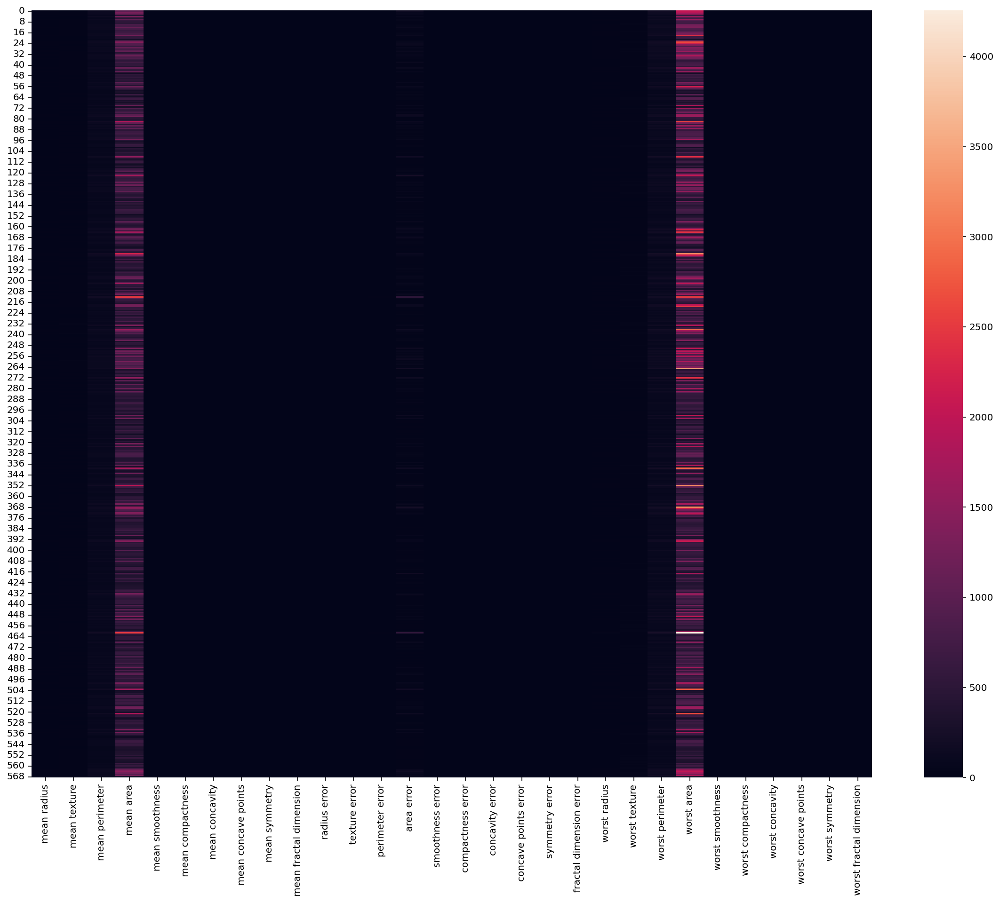

In [17]:
plt.figure(figsize=(20,15))
sns.heatmap(X)

<AxesSubplot:>

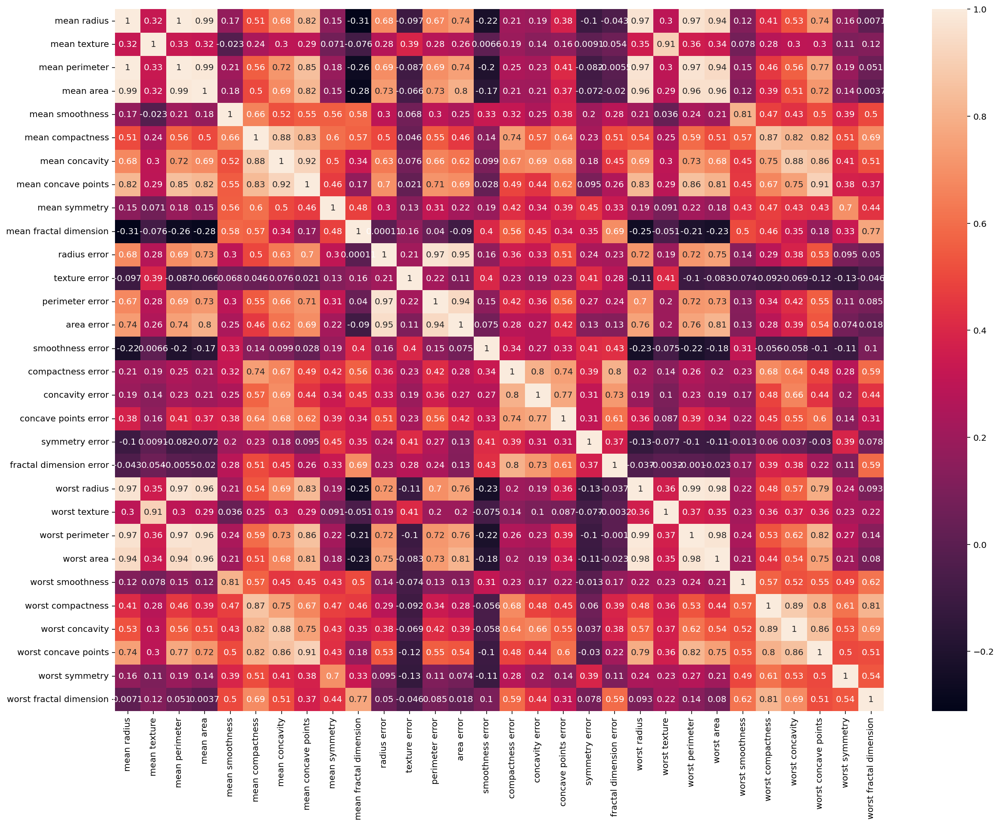

In [20]:
plt.figure(figsize=(20,15))
sns.heatmap(X.corr(), annot=True)

In [25]:
def drop_corr(df, threshold=0.77):
    """Drops columns in df that have a correlation greater than threshold.
    
    Parameters
    ----------
    df : pd.Dataframe
        Dataframe containing data to analyse.
    thershold : float
        Correlation thershold to drop column.
        Default: 0.77
    
    Returns
    -------
    df : pd.Dataframe
        The dataframe with dropped columns.
    """
    # Correlation matrix
    corr_matrix = df.corr()
    
    drop_cols = []
    for i in range(len(corr_matrix)-1):
        for j in range(i):
            pos = corr_matrix.iloc[(j):(j+1), (i+1):(i+2)]
            if abs(pos.values) >= threshold:
                drop_cols.append(i)
                
    for i in set(drop_cols):
        col_to_drop = corr_matrix.iloc[:, (i+1):(i+2)]
        df = df.drop(col_to_drop, axis=1)
        
    return df
    

In [27]:
corr_matrix = X.corr().abs()
high_corr_var=np.where(corr_matrix>=0.77)
high_corr_var=[(corr_matrix.columns[x],corr_matrix.columns[y]) for x,y in zip(*high_corr_var) if x!=y and x<y]

In [28]:
high_corr_var

[('mean radius', 'mean perimeter'),
 ('mean radius', 'mean area'),
 ('mean radius', 'mean concave points'),
 ('mean radius', 'worst radius'),
 ('mean radius', 'worst perimeter'),
 ('mean radius', 'worst area'),
 ('mean texture', 'worst texture'),
 ('mean perimeter', 'mean area'),
 ('mean perimeter', 'mean concave points'),
 ('mean perimeter', 'worst radius'),
 ('mean perimeter', 'worst perimeter'),
 ('mean perimeter', 'worst area'),
 ('mean perimeter', 'worst concave points'),
 ('mean area', 'mean concave points'),
 ('mean area', 'area error'),
 ('mean area', 'worst radius'),
 ('mean area', 'worst perimeter'),
 ('mean area', 'worst area'),
 ('mean smoothness', 'worst smoothness'),
 ('mean compactness', 'mean concavity'),
 ('mean compactness', 'mean concave points'),
 ('mean compactness', 'worst compactness'),
 ('mean compactness', 'worst concavity'),
 ('mean compactness', 'worst concave points'),
 ('mean concavity', 'mean concave points'),
 ('mean concavity', 'worst concavity'),
 ('mea

In [29]:
X_reduced = drop_corr(X)

In [30]:
X_reduced

,mean radius,mean texture,mean smoothness,mean compactness,mean concavity,mean symmetry,mean fractal dimension,radius error,texture error,smoothness error,compactness error,concavity error,concave points error,symmetry error,worst symmetry
0,17.99,10.38,0.11840,0.27760,0.30010,0.2419,0.07871,1.0950,0.9053,0.006399,0.04904,0.05373,0.01587,0.03003,0.4601
1,20.57,17.77,0.08474,0.07864,0.08690,0.1812,0.05667,0.5435,0.7339,0.005225,0.01308,0.01860,0.01340,0.01389,0.2750
2,19.69,21.25,0.10960,0.15990,0.19740,0.2069,0.05999,0.7456,0.7869,0.006150,0.04006,0.03832,0.02058,0.02250,0.3613
3,11.42,20.38,0.14250,0.28390,0.24140,0.2597,0.09744,0.4956,1.1560,0.009110,0.07458,0.05661,0.01867,0.05963,0.6638
4,20.29,14.34,0.10030,0.13280,0.19800,0.1809,0.05883,0.7572,0.7813,0.011490,0.02461,0.05688,0.01885,0.01756,0.2364
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,0.11100,0.11590,0.24390,0.1726,0.05623,1.1760,1.2560,0.010300,0.02891,0.05198,0.02454,0.01114,0.2060
565,20.13,28.25,0.09780,0.10340,0.14400,0.1752,0.05533,0.7655,2.4630,0.005769,0.02423,0.03950,0.01678,0.01898,0.2572
566,16.60,28.08,0.08455,0.10230,0.09251,0.1590,0.05648,0.4564,1.0750,0.005903,0.03731,0.04730,0.01557,0.01318,0.2218
567,20.60,29.33,0.11780,0.27700,0.35140,0.2397,0.07016,0.7260,1.5950,0.006522,0.06158,0.07117,0.01664,0.02324,0.4087


In [32]:
X_reduced_train, X_reduced_test, y_train, y_test = train_test_split(X_reduced, y, test_size=0.15)

In [33]:
dt = DecisionTreeClassifier()

dt.fit(X_reduced_train, y_train)

DecisionTreeClassifier()

In [34]:
y_pred = dt.predict(X_reduced_test)

In [36]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.92      0.92      0.92        26
           1       0.97      0.97      0.97        60

    accuracy                           0.95        86
   macro avg       0.94      0.94      0.94        86
weighted avg       0.95      0.95      0.95        86



In [37]:
lr = LogisticRegression()

lr.fit(X_reduced_train, y_train)

LogisticRegression()

In [38]:
print(classification_report(y_test, lr.predict(X_reduced_test)))

              precision    recall  f1-score   support

           0       0.96      0.88      0.92        26
           1       0.95      0.98      0.97        60

    accuracy                           0.95        86
   macro avg       0.95      0.93      0.94        86
weighted avg       0.95      0.95      0.95        86



In [41]:
scaler = MinMaxScaler()
X_reduced_train = scaler.fit_transform(X_reduced_train)
X_reduced_test = scaler.transform(X_reduced_test)

lr_scaled = LogisticRegression().fit(X_reduced_train, y_train)

print(classification_report(y_test, lr_scaled.predict(X_reduced_test)))

              precision    recall  f1-score   support

           0       1.00      0.88      0.94        26
           1       0.95      1.00      0.98        60

    accuracy                           0.97        86
   macro avg       0.98      0.94      0.96        86
weighted avg       0.97      0.97      0.96        86



In [47]:
train_sizes = [.01, .2, .3, .5, .7, .9, 1.]

In [48]:
train_sizes, train_scores, validation_scores = learning_curve(estimator = LogisticRegression(),
                                                            X = X_reduced_train,
                                                            y = y_train, train_sizes = train_sizes, cv = 5,
                                                            scoring = 'f1')

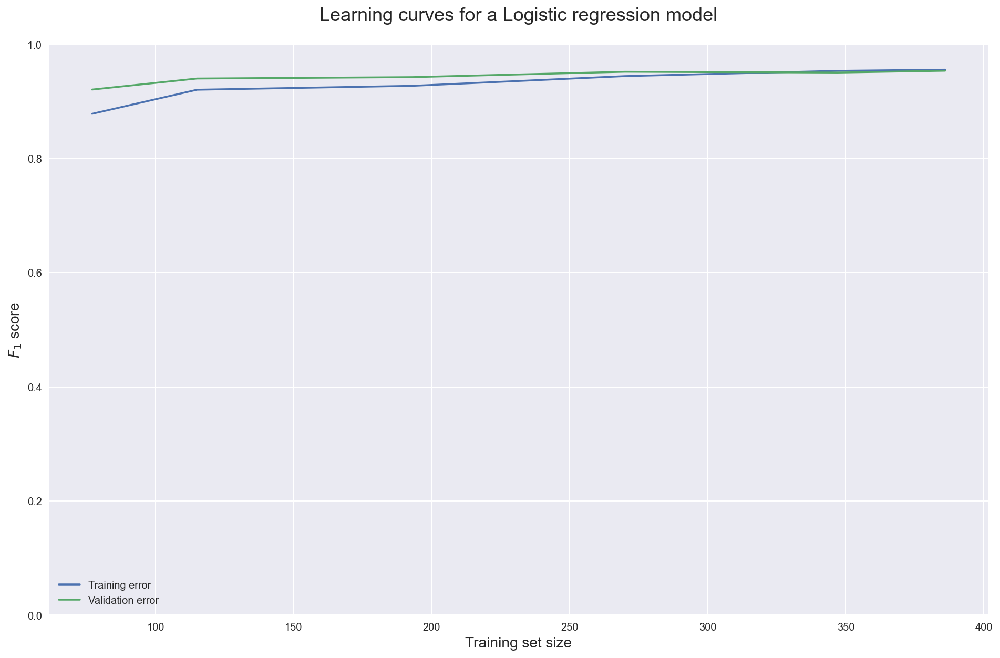

In [50]:
plt.style.use('seaborn')
plt.figure(figsize = (16,10))
plt.plot(train_sizes, train_scores.mean(axis=1), label = 'Training error')
plt.plot(train_sizes, validation_scores.mean(axis=1), label = 'Validation error')
plt.ylabel(r'$F_1$ score', fontsize = 14)
plt.xlabel('Training set size', fontsize = 14)
plt.title('Learning curves for a Logistic regression model', fontsize = 18, y = 1.03)
plt.ylim(0,1)
plt.legend();

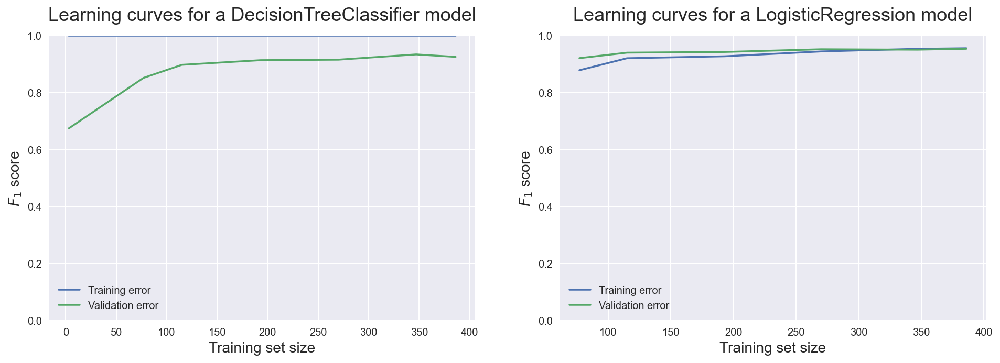

In [52]:
### Bundling our previous work into a function ###
def learning_curves(estimator, features, target, train_sizes, cv):
    train_sizes, train_scores, validation_scores = learning_curve(
    estimator, features, target, train_sizes =
    train_sizes,
    cv = cv, scoring = 'f1')
    train_scores_mean = train_scores.mean(axis = 1)
    validation_scores_mean = validation_scores.mean(axis = 1)

    plt.plot(train_sizes, train_scores_mean, label = 'Training score')
    plt.plot(train_sizes, validation_scores_mean, label = 'Validation score')

    plt.ylabel(r'$F_1$ score', fontsize = 14)
    plt.xlabel('Training set size', fontsize = 14)
    title = 'Learning curves for a ' + str(estimator).split('(')[0] + ' model'
    plt.title(title, fontsize = 18, y = 1.03)
    plt.legend()
    plt.ylim(0,1)

### Plotting the two learning curves ###

plt.figure(figsize = (16,5))

for model, i in [(DecisionTreeClassifier(max_depth=10), 1), (LogisticRegression(),2)]:
    plt.subplot(1,2,i)
    learning_curves(model, X_reduced_train, y_train, train_sizes, 5)